In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from processing import ProcessingPipeline
pipeline = ProcessingPipeline(notebook=True)
pipeline.pre_process_las_files("../data/2018/")

Found total of 14 las files.
The corner tile is file ../data/2018/4800E_54550N.las at 4800 54550
Loading file ../data/2018/4800E_54560N.las.
Down size to 24189 from 2418920
Loading file ../data/2018/4800E_54550N.las.
Loading file ../data/2018/4810E_54540N.las.
No trees are classified on the tile
Loading file ../data/2018/4810E_54570N.las.
Down size to 21405 from 21405663
Loading file ../data/2018/4820E_54530N.las.
No trees are classified on the tile
Loading file ../data/2018/4810E_54550N.las.
Down size to 15503 from 15503081
Loading file ../data/2018/4820E_54570N.las.
Down size to 28384 from 28384744
Loading file ../data/2018/4820E_54550N.las.
Down size to 29146 from 29146667
Loading file ../data/2018/4820E_54540N.las.
Down size to 94020 from 9402070
Loading file ../data/2018/4810E_54560N.las.
Down size to 20891 from 20891997
Loading file ../data/2018/4820E_54560N.las.
Down size to 18687 from 18687492
Loading file ../data/2018/4810E_54580N.las.
Down size to 44467 from 4446742
Loading f

In [11]:
from processing import ProcessingPipeline
pipeline = ProcessingPipeline(notebook=True)
pipeline.pre_process_las_files("../data/2015/")

Found total of 1 las files.
The corner tile is file ../data/2015/4810E_54560N.las at 4810 54560
Loading file ../data/2015/4810E_54560N.las.
Down size to 57554 from 575545


In [12]:
test_file = pipeline.pre_processor.lasfile_list[-1]

display_2d(test_file.point_x, test_file.point_y)
test_file.point_x.shape

(57554,)

In [13]:
from sklearn.cluster import DBSCAN, OPTICS
import numpy as np
eps = 400
min_sample = 10
points = np.vstack((test_file.point_x, test_file.point_y)).T
# clustering = DBSCAN(min_samples=min_sample, algorithm='ball_tree', metric='haversine', n_jobs=12).fit(points)
clustering = OPTICS(max_eps=eps, min_samples=min_sample, n_jobs=12).fit(points)
print(np.amax(clustering.labels_))

1407


In [6]:
def display_2d(point_x, point_y):
    import plotly.graph_objects as go
    from PIL import Image
    small_img = Image.open("../data/481E_5456N_tiny.png")
    size = 1000, 1000
    fig = go.Figure(data=go.Scattergl(
    x = point_x,
    y = point_y,
    mode='markers',
    marker=dict(
        size=3,
#         color=z,                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )))

    area = (0, 0, 100, 100)
    
    offset = 100000
    crop = small_img.crop(area)

    # Add images
    fig.add_layout_image(
            dict(
                source=small_img,
                xref="x",
                yref="y",
                x=0 + offset,
                y=100000 + offset,
                sizex=100000,
                sizey=100000,
                sizing="stretch",
                opacity=0.8,
                layer="below")
    )

    # Set templates
    fig.update_layout(template="plotly_white")

    fig.update_yaxes(
        scaleanchor = "x",
        scaleratio = 1,
      )
    fig.show()
import plotly.io as pio
# too many points, cannot render embedded
pio.renderers.default = "browser"

display_2d(test_file.point_x, test_file.point_y)

NameError: name 'test_file' is not defined

In [5]:
from sklearn.cluster import DBSCAN
import numpy as np
# we are in cm unit
def display_cluster(las_file, eps, min_sample):
    import plotly.graph_objects as go
    from PIL import Image
    small_img = Image.open("../data/481E_5456N_tiny.png")
    size = 1000, 1000
    points = np.vstack((las_file.point_x, las_file.point_y)).T
    clustering = DBSCAN(eps=eps, min_samples=min_sample, n_jobs=12).fit(points)
    clustering.labels_

    print(np.amax(clustering.labels_))
    fig = go.Figure()
    for i in np.arange(np.amax(clustering.labels_)):
        x_cluster = las_file.point_x[np.where(clustering.labels_ == i)]
        y_cluster = las_file.point_y[np.where(clustering.labels_ == i)]
        fig.add_trace(go.Scattergl(x=x_cluster, y=y_cluster,
                                    mode='markers',
                                    marker=dict(
                                        size=3,
                                #         color=z,                # set color to an array/list of desired values
                                        colorscale='Viridis',   # choose a colorscale
                                        opacity=0.8
    )))

    area = (0, 0, 100, 100)
    
    offset = 100000
    crop = small_img.crop(area)

    # Add images
    fig.add_layout_image(
            dict(
                source=small_img,
                xref="x",
                yref="y",
                x=0 + offset,
                y=100000 + offset,
                sizex=100000,
                sizey=100000,
                sizing="stretch",
                opacity=0.5,
                layer="below")
    )

    fig.update_yaxes(
        scaleanchor = "x",
        scaleratio = 1,
    )
    fig.show()
    
display_cluster(test_file, 800, 15)

NameError: name 'test_file' is not defined

In [9]:
display_cluster(test_file, 300, 15)

-1


In [10]:
display_cluster(test_file, 300, 10)

6


In [13]:
points = np.vstack((test_file.point_x, test_file.point_y)).T
clustering = DBSCAN(eps=300, min_samples=10, n_jobs=12).fit(points)

x_cluster = test_file.point_x[np.where(clustering.labels_ == 0)]
y_cluster = test_file.point_y[np.where(clustering.labels_ == 0)]

In [14]:
display_2d(x_cluster,y_cluster)

In [ ]:
from scipy.spatial import ConvexHull, convex_hull_plot_2d
label = 0
x_cluster = test_file.point_x[np.where(clustering.labels_ == label)]
y_cluster = test_file.point_y[np.where(clustering.labels_ == label)]
display_2d(x_cluster,y_cluster)
cluster_points = np.vstack((x_cluster, y_cluster)).T
hull = ConvexHull(cluster_points)

import matplotlib.pyplot as plt
plt.plot(cluster_points[:,0], cluster_points[:,1], 'o')
for simplex in hull.simplices:
    plt.plot(cluster_points[simplex, 0], cluster_points[simplex, 1], 'k-')

In [ ]:
from alpha_shapes.alpha_shapes import Alpha_Shaper
shaper = Alpha_Shaper(cluster_points)
alpha_shape = shaper.get_shape(alpha=0)
print(alpha_shape.area)
alpha_shape


In [ ]:
cluster_points.shape

In [ ]:
down_sample = np.random.choice(np.arange(cluster_points.shape[0]), 929)
default_alphashape = alphashape.alphashape(cluster_points[down_sample])
default_alphashape

In [48]:
pipeline = ProcessingPipeline(notebook=True)
pipeline.pre_process_las_files("../data/2018/")

Found total of 19 las files.
The corner tile is file ../data/2018/4800E_54550N.las at 4800 54550
Loading file ../data/2018/4800E_54560N.las.
Down size to 24189 from 2418920
Loading file ../data/2018/4800E_54550N.las.
Loading file ../data/2018/4810E_54540N.las.
No trees are classified on the tile
Loading file ../data/2018/4810E_54570N.las.
Down size to 21405 from 21405663
Loading file ../data/2018/4830E_54570N.las.
Down size to 51388 from 51388676
Loading file ../data/2018/4820E_54530N.las.
No trees are classified on the tile
Loading file ../data/2018/4810E_54550N.las.
Down size to 15503 from 15503081
Loading file ../data/2018/4820E_54570N.las.
Down size to 28384 from 28384744
Loading file ../data/2018/4830E_54550N.las.
Down size to 56370 from 56370480
Loading file ../data/2018/4820E_54550N.las.
Down size to 29146 from 29146667
Loading file ../data/2018/4820E_54540N.las.
Down size to 94020 from 9402070
Loading file ../data/2018/4830E_54560N.las.
Down size to 46829 from 46829637
Loading 

In [49]:
import numpy as np
all_point_x = np.array([])
all_point_y = np.array([])


for las_file in pipeline.pre_processor.lasfile_list:
    if las_file.valid:
        all_point_x = np.append(all_point_x, las_file.point_x)
        all_point_y = np.append(all_point_y, las_file.point_y)

print(all_point_x.shape)
display_2d(all_point_x, all_point_y)


(587743,)


In [30]:
points = np.vstack((all_point_x, all_point_y)).T
points[:, 1]

array([193278., 181478., 187230., ..., 349981., 332455., 349783.])

1065


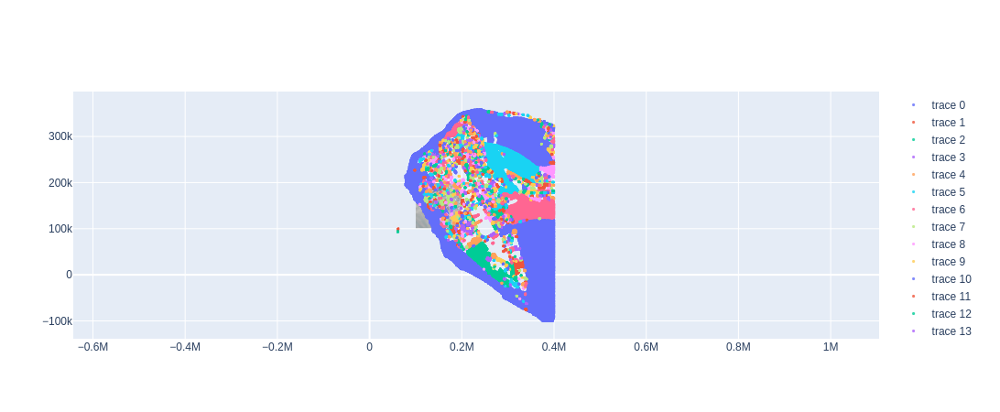

(12399,)

In [53]:
points = np.vstack((all_point_x, all_point_y)).T
from sklearn.cluster import DBSCAN, OPTICS
# Cluster the points based on paramters

# clustering = OPTICS(max_eps=pipeline.EPS, min_samples=pipeline.MIN_SAMPLE, n_jobs=12).fit(points)
# clustering = DBSCAN(eps=pipeline.EPS, min_samples=pipeline.MIN_SAMPLE, algorithm='ball_tree', metric='haversine', n_jobs=12).fit(points)
import plotly.graph_objects as go
from PIL import Image
small_img = Image.open("../data/481E_5456N_tiny.png")
size = 1000, 1000
clustering = DBSCAN(eps=1000, min_samples=10, algorithm='kd_tree', n_jobs=12).fit(points)
# clustering = OPTICS(max_eps=pipeline.EPS, min_samples=pipeline.MIN_SAMPLE, n_jobs=12).fit(points)

print(np.amax(clustering.labels_))
fig = go.Figure()
for i in np.arange(np.amax(clustering.labels_)):
    x_cluster = points[:, 0][np.where(clustering.labels_ == i)]
    y_cluster = points[:, 1][np.where(clustering.labels_ == i)]
    fig.add_trace(go.Scattergl(x=x_cluster, y=y_cluster,
            mode='markers',
            marker=dict(
                size=3,
        #         color=z,                # set color to an array/list of desired values
                colorscale='Viridis',   # choose a colorscale
                opacity=0.8
)))

area = (0, 0, 100, 100)

offset = 100000
crop = small_img.crop(area)

# Add images
fig.add_layout_image(
        dict(
            source=small_img,
            xref="x",
            yref="y",
            x=0 + offset,
            y=100000 + offset,
            sizex=100000,
            sizey=100000,
            sizing="stretch",
            opacity=0.5,
            layer="below")
)

fig.update_yaxes(
    scaleanchor = "x",
    scaleratio = 1,
)
fig.show()
points[:, 0][np.where(clustering.labels_ == -1)].shape

In [55]:
fig.write_html("../tests/module_output.html")